In [18]:
from parcels import FieldSet, ParticleSet, JITParticle, ParticleFile, ErrorCode
from parcels import AdvectionRK4
import numpy as np
import xarray
from datetime import timedelta

import matplotlib.pyplot as plt
%matplotlib inline
import cmocean.cm as cmo

def DeleteParticle(particle, fieldset, time):
    particle.delete()

In [3]:
# ds = xarray.open_zarr('/Users/hetl729/Data/Frontogenesis/surface_parent_subset.zarr',
#                       consolidated=True)
ds = xarray.open_zarr('/Users/hetl729/Data/Frontogenesis/surface_child.zarr',
                      consolidated=True)

ds = ds.sel(ocean_time=slice('2010-06-15', '2010-06-20'))
ds, grid = xroms.roms_dataset(ds, Vtransform=1)

In [4]:
ds['up'] = xarray.DataArray(
                data=ds.u.values[:, :-1, :].data,
                dims=['ocean_time', 'eta_v', 'xi_u']
            )
ds['vp'] = xarray.DataArray(
                data=ds.v.values[:, :, :-1].data,
                dims=['ocean_time', 'eta_v', 'xi_u']
            )
ds['saltp'] = xarray.DataArray(
                data=ds.salt.values[:, :-1, :-1].data,
                dims=['ocean_time', 'eta_v', 'xi_u']
            )

bry = {'boundary': 'extend'}
ds['dudy'] = grid.derivative(ds.u, axis='Y', **bry)
ds['dvdx'] = grid.derivative(ds.v, axis='X', **bry)
ds['vort'] = (ds.dvdx - ds.dudy)/ds.f.mean()

In [6]:
variables = {'U': 'up', 'V': 'vp', 'salt': 'saltp', 'vort': 'vort'}
dimensions = {'lon': 'lon_psi', 'lat': 'lat_psi', 'time': 'ocean_time'}
fieldset = FieldSet.from_xarray_dataset(ds, variables, dimensions, 
                                        interp_method='cgrid_velocity',
                                        gridindexingtype='nemo')

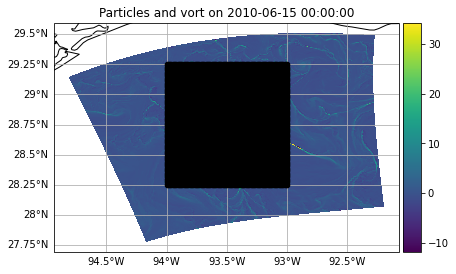

In [7]:
nparticles = 100

lon, lat = np.meshgrid(np.linspace(-94, -93, nparticles), np.linspace(28.25, 29.25, nparticles))
pset = ParticleSet(fieldset=fieldset, 
                   pclass=JITParticle,
                   lon=lon, lat=lat)   

pset.show(field=fieldset.vort)

INFO: Compiled JITParticleAdvectionRK4 ==> /var/folders/y_/vp5v56qd4nj5b07f89_ww3fnsbfrqc/T/parcels-1924621036/782d1181bf98204b43e602de4b85006b_0.so
INFO: Temporary output files are stored in out-SNROXTGP.
INFO: You can use "parcels_convert_npydir_to_netcdf out-SNROXTGP" to convert these to a NetCDF file during the run.
100% (259200.0 of 259200.0) |############| Elapsed Time: 0:00:12 Time:  0:00:12


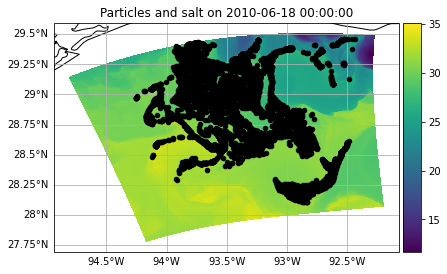

In [8]:
output_file = pset.ParticleFile(name='foo.nc', outputdt=timedelta(hours=1))
pset.write=True
pset.execute(AdvectionRK4,                 # the kernel (which defines how particles move)
             runtime=timedelta(days=3),    # the total length of the run
             dt=timedelta(minutes=5),      # the timestep of the kernel
             output_file=output_file,
             recovery={ErrorCode.ErrorOutOfBounds: DeleteParticle}
            )

output_file.export()
pset.show(field=fieldset.salt)

In [9]:
data_xarray=xarray.open_dataset('foo.nc')
data_xarray.time.values

array([['2010-06-15T00:00:00.000000000', '2010-06-15T01:00:00.000000000',
        '2010-06-15T02:00:00.000000000', ...,
        '2010-06-17T22:00:00.000000000', '2010-06-17T23:00:00.000000000',
        '2010-06-18T00:00:00.000000000'],
       ['2010-06-15T00:00:00.000000000', '2010-06-15T01:00:00.000000000',
        '2010-06-15T02:00:00.000000000', ...,
        '2010-06-17T22:00:00.000000000', '2010-06-17T23:00:00.000000000',
        '2010-06-18T00:00:00.000000000'],
       ['2010-06-15T00:00:00.000000000', '2010-06-15T01:00:00.000000000',
        '2010-06-15T02:00:00.000000000', ...,
        '2010-06-17T22:00:00.000000000', '2010-06-17T23:00:00.000000000',
        '2010-06-18T00:00:00.000000000'],
       ...,
       ['2010-06-15T00:00:00.000000000', '2010-06-15T01:00:00.000000000',
        '2010-06-15T02:00:00.000000000', ...,
        '2010-06-17T22:00:00.000000000', '2010-06-17T23:00:00.000000000',
        '2010-06-18T00:00:00.000000000'],
       ['2010-06-15T00:00:00.000000000', '20

In [10]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

outputdt = timedelta(hours=1)
timerange = np.arange(np.nanmin(data_xarray['time'].values),
                      np.nanmax(data_xarray['time'].values)+np.timedelta64(outputdt), 
                      outputdt)  # timerange in nanoseconds

In [32]:
%%capture
fig = plt.figure(figsize=(8,8),constrained_layout=True)
ax = fig.add_subplot()

ax.set_aspect(1.0/np.cos(28.5*np.pi/180.0))
ax.set_xlim(-94.5, -92.5)
ax.set_ylim(28, 29.5)
# time_id = np.where(data_xarray['time'] == timerange[0]) # Indices of the data where time = 0
time_id = 0

scatter = ax.scatter(data_xarray['lon'].values[time_id], 
                     data_xarray['lat'].values[time_id], 
                     1, alpha=0.5, color='b')
# pcm = ax.pcolormesh(ds.lon_psi, ds.lat_psi, ds.salt[0, 1:-1, 1:-1], zorder=-1e32)
pcm = ax.pcolormesh(ds.lon_rho, ds.lat_rho, ds.vort[0], 
                    zorder=-1e32, vmin=-3, vmax=3, cmap=cmo.curl)

t = str(timerange[0])
title = ax.set_title('Particles at t = '+t)

def animate(i):
    t = str(timerange[i])
    title.set_text('Particles at t = '+t)
    
    time_id = np.where(data_xarray['time'] == timerange[i])
    scatter.set_offsets(np.c_[data_xarray['lon'].values[time_id], data_xarray['lat'].values[time_id]])
    pcm.set_array(ds.vort[i])
    
anim = FuncAnimation(fig, animate, frames = len(timerange), interval=500)

In [33]:
HTML(anim.to_jshtml())

Animation size has reached 21639218 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [31]:
anim.save('surface_drifters.mp4', fps=10)

In [34]:
np.c_?

Type:        CClass
String form: <numpy.lib.index_tricks.CClass object at 0x7fa6c0bfa6d0>
Length:      0
File:        ~/miniconda3/envs/parcels/lib/python3.7/site-packages/numpy/lib/index_tricks.py
Docstring:  
Translates slice objects to concatenation along the second axis.

This is short-hand for ``np.r_['-1,2,0', index expression]``, which is
useful because of its common occurrence. In particular, arrays will be
stacked along their last axis after being upgraded to at least 2-D with
1's post-pended to the shape (column vectors made out of 1-D arrays).

See Also
--------
column_stack : Stack 1-D arrays as columns into a 2-D array.
r_ : For more detailed documentation.

Examples
--------
>>> np.c_[np.array([1,2,3]), np.array([4,5,6])]
array([[1, 4],
       [2, 5],
       [3, 6]])
>>> np.c_[np.array([[1,2,3]]), 0, 0, np.array([[4,5,6]])]
array([[1, 2, 3, ..., 4, 5, 6]])
